# Image to image translation with conditional GANs

`@author Daniel Ramírez Vaquero`

In this notebook we will work on the variants of GAN ```Image_to_Image Translation``` that tries to generate a realistic image from another that can be anything from a simple drawing to a scheme of segments of different colors as in this case.

The dataset that we will use is [CMF Facades](https://huggingface.co/datasets/Xpitfire/cmp_facade), common for researching this type of GAN. In this dataset we will find pairs of images, in the first column they contain real images of building facades and in the second their representation in colored segments.

# Environment Setup and Dependencies
Install and import required libraries: torch, torchvision, PIL, matplotlib, numpy. Will use CMP Facades or Maps dataset as example.

In [ ]:
# Environment Setup and Dependencies

# Import required libraries
import torch
import torch.nn as nn
from torch.utils.data import Dataset
import matplotlib.pyplot as plt
from PIL import Image
import io

# Check if CUDA is available and set the device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

Using device: cuda


In [23]:
# Load the dataset with pandas
import pandas as pd

splits = {'train': 'data/train-00000-of-00001-79d44ab6865989f1.parquet', 'test': 'data/test-00000-of-00001-1ba52e9214118652.parquet', 'eval': 'data/eval-00000-of-00001-14ff7f0dec46b299.parquet'}
df = pd.read_parquet("hf://datasets/Xpitfire/cmp_facade/" + splits["train"])

# Dataset Preparation and Loading
Create custom dataset class, implement data loading and preprocessing, including image pairing and transformations.

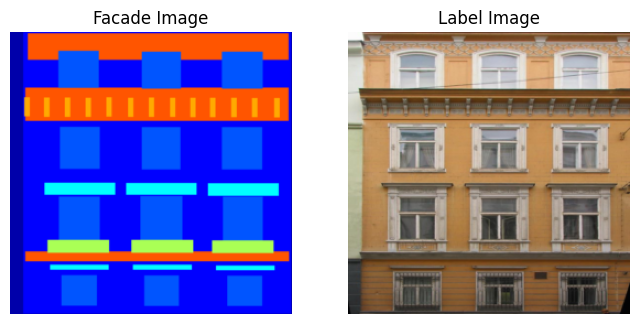

In [24]:
import torchvision.transforms as transforms
from torchvision.datasets import ImageFolder
from torch.utils.data import DataLoader

class FacadeDataset(Dataset):
    def __init__(self, dataframe, transform=None):
        self.dataframe = dataframe
        self.transform = transform

    def __len__(self):
        return len(self.dataframe)

    def __getitem__(self, idx):
        # Obtener las imágenes del dataframe
        facade_img = Image.open(io.BytesIO(self.dataframe.iloc[idx]['pixel_values']['bytes'])).convert('RGB')
        label_img = Image.open(io.BytesIO(self.dataframe.iloc[idx]['label']['bytes'])).convert('RGB')
        
        if self.transform:
            facade_img = self.transform(facade_img)
            label_img = self.transform(label_img)
            
        # Retornamos label_img como input y facade_img como target
        return label_img, facade_img  

# Definir transformaciones
transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

# Crear dataset
facade_dataset = FacadeDataset(df, transform=transform)

# Crear dataloader
batch_size = 4
dataloader = DataLoader(facade_dataset, batch_size=batch_size, shuffle=True)

# Display a sample image from the dataset
facade_img, label_img = next(iter(dataloader))

# Desnormalizar las imágenes
def denormalize(img):
    img = img.clone().detach()  # Crear una copia para no modificar el tensor original
    img = img * 0.5 + 0.5  # Desnormalizar: [-1,1] -> [0,1]
    return img.permute(1, 2, 0)

plt.figure(figsize=(8, 8))
plt.subplot(1, 2, 1)
plt.imshow(denormalize(facade_img[0]))
plt.title("Facade Image")
plt.axis('off')
plt.subplot(1, 2, 2)
plt.imshow(denormalize(label_img[0]))
plt.title("Label Image")
plt.axis('off')
plt.show()

# Generator Architecture
Implement U-Net based generator with skip connections using PyTorch, following the Pix2Pix architecture.

In [ ]:
# Generator Architecture

class UNetGenerator(nn.Module):
    def __init__(self, in_channels, out_channels, features=64):
        super(UNetGenerator, self).__init__()
        self.encoder = nn.ModuleList([
            self._block(in_channels, features, name="enc1", use_batch_norm=False),
            self._block(features, features * 2, name="enc2"),
            self._block(features * 2, features * 4, name="enc3"),
            self._block(features * 4, features * 8, name="enc4"),
            self._block(features * 8, features * 8, name="enc5"),
            self._block(features * 8, features * 8, name="enc6"),
            self._block(features * 8, features * 8, name="enc7"),
        ])
        self.bottleneck = nn.Sequential(
            nn.Conv2d(features * 8, features * 8, kernel_size=4, stride=2, padding=1),
            nn.ReLU(inplace=True),
        )
        self.decoder = nn.ModuleList([
            self._block(features * 8, features * 8, name="dec1", use_transpose=True),
            self._block(features * 16, features * 8, name="dec2", use_transpose=True),
            self._block(features * 16, features * 8, name="dec3", use_transpose=True),
            self._block(features * 16, features * 8, name="dec4", use_transpose=True),
            self._block(features * 16, features * 4, name="dec5", use_transpose=True),
            self._block(features * 8, features * 2, name="dec6", use_transpose=True),
            self._block(features * 4, features, name="dec7", use_transpose=True),
        ])
        self.final_layer = nn.Sequential(
            nn.ConvTranspose2d(features * 2, out_channels, kernel_size=4, stride=2, padding=1),
            nn.Tanh(),
        )

    def _block(self, in_channels, out_channels, name, use_batch_norm=True, use_transpose=False):
        if use_transpose:
            layers = [
                nn.ConvTranspose2d(in_channels, out_channels, kernel_size=4, stride=2, padding=1),
                nn.ReLU(inplace=True),
            ]
        else:
            layers = [
                nn.Conv2d(in_channels, out_channels, kernel_size=4, stride=2, padding=1),
                nn.ReLU(inplace=True),
            ]
        if use_batch_norm:
            layers.insert(1, nn.BatchNorm2d(out_channels))
        return nn.Sequential(*layers)

    def forward(self, x):
        enc_results = []
        for layer in self.encoder:
            x = layer(x)
            enc_results.append(x)
        x = self.bottleneck(x)
        enc_results = enc_results[::-1]
        for idx, layer in enumerate(self.decoder):
            x = layer(x)
            x = torch.cat((x, enc_results[idx]), dim=1)
        return self.final_layer(x)

# Instantiate the generator
gen = UNetGenerator(in_channels=3, out_channels=3).to(device)

# Print the generator architecture
print(gen)

UNetGenerator(
  (encoder): ModuleList(
    (0): Sequential(
      (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (1): ReLU(inplace=True)
    )
    (1): Sequential(
      (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (2): Sequential(
      (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (3): Sequential(
      (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (4-6): 3 x Sequential(
      (0): Conv2d(512, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (1): BatchNorm2d(512, eps=1e-05,

# Discriminator Architecture
Create PatchGAN discriminator using convolutional layers for identifying real vs generated image pairs.

In [26]:
import torch.nn as nn

class PatchGANDiscriminator(nn.Module):
    def __init__(self, in_channels, features=64):
        super(PatchGANDiscriminator, self).__init__()
        self.model = nn.Sequential(
            self._block(in_channels * 2, features, stride=2, use_batch_norm=False),
            self._block(features, features * 2, stride=2),
            self._block(features * 2, features * 4, stride=2),
            self._block(features * 4, features * 8, stride=1),
            nn.Conv2d(features * 8, 1, kernel_size=4, stride=1, padding=1)
        )

    def _block(self, in_channels, out_channels, stride, use_batch_norm=True):
        layers = [
            nn.Conv2d(in_channels, out_channels, kernel_size=4, stride=stride, padding=1),
            nn.LeakyReLU(0.2, inplace=True)
        ]
        if use_batch_norm:
            layers.append(nn.BatchNorm2d(out_channels))
        return nn.Sequential(*layers)

    def forward(self, x):
        return self.model(x)

# Instantiate the discriminator
disc = PatchGANDiscriminator(in_channels=3).to(device)

# Print the discriminator architecture
print(disc)

PatchGANDiscriminator(
  (model): Sequential(
    (0): Sequential(
      (0): Conv2d(6, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (1): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (1): Sequential(
      (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (1): LeakyReLU(negative_slope=0.2, inplace=True)
      (2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (2): Sequential(
      (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (1): LeakyReLU(negative_slope=0.2, inplace=True)
      (2): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (3): Sequential(
      (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(1, 1), padding=(1, 1))
      (1): LeakyReLU(negative_slope=0.2, inplace=True)
      (2): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (4): Conv2d(512, 1, kernel_size=(4

# Training Loop Implementation
Set up the GAN training loop with adversarial and L1 losses, implement the training function with proper logging.

In [ ]:
import os

# Function to save generated images
def save_generated_images(epoch, gen, dataloader, device, output_dir="./assets/generated_images"):
    os.makedirs(output_dir, exist_ok=True)
    gen.eval()
    with torch.no_grad():
        for idx, (input_image, target_image) in enumerate(dataloader):
            if idx >= 1:  # Save only one batch of images
                break
            input_image = input_image.to(device)
            fake_image = gen(input_image)
            input_image = input_image[0].permute(1, 2, 0).cpu().numpy()
            input_image = (input_image * 0.5) + 0.5  # Unnormalize the image
            fake_image = fake_image[0].permute(1, 2, 0).cpu().numpy()
            fake_image = (fake_image * 0.5) + 0.5  # Unnormalize the image
            target_image = target_image[0].permute(1, 2, 0).cpu().numpy()
            target_image = (target_image * 0.5) + 0.5  # Unnormalize the image

            fig, axes = plt.subplots(1, 3, figsize=(15, 5))
            axes[0].imshow(input_image)
            axes[0].set_title('Input Image')
            axes[0].axis('off')
            axes[1].imshow(fake_image)
            axes[1].set_title('Generated Image')
            axes[1].axis('off')
            axes[2].imshow(target_image)
            axes[2].set_title('Target Image')
            axes[2].axis('off')
            plt.savefig(os.path.join(output_dir, f"epoch_{epoch}.png"))
            plt.show()

Epoch [4/100]: 100%|██████████| 95/95 [00:19<00:00,  4.79it/s, loss_disc=0.215, loss_gen=35.8] 


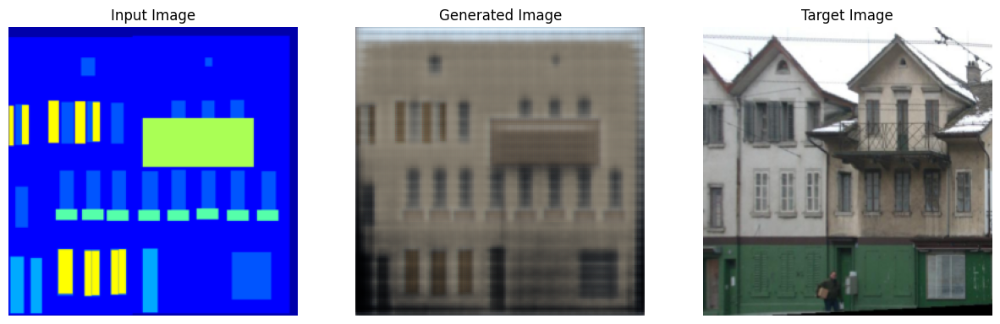

Epoch [9/100]: 100%|██████████| 95/95 [00:19<00:00,  4.96it/s, loss_disc=0.382, loss_gen=26.3] 


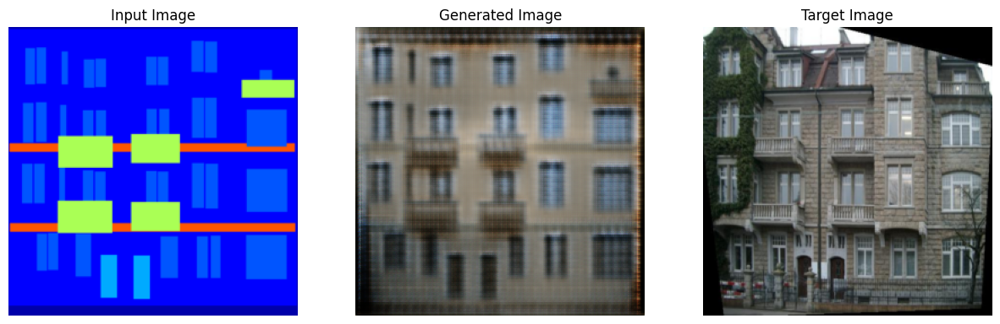

Epoch [14/100]: 100%|██████████| 95/95 [00:20<00:00,  4.69it/s, loss_disc=0.167, loss_gen=30.8] 


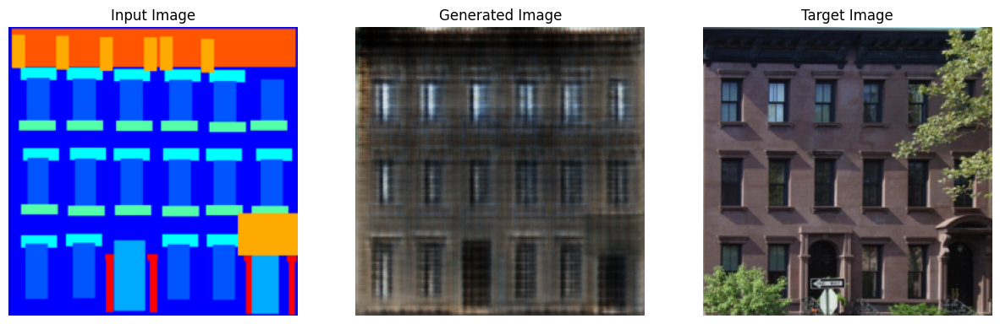

Epoch [19/100]: 100%|██████████| 95/95 [00:20<00:00,  4.66it/s, loss_disc=0.208, loss_gen=28.8]


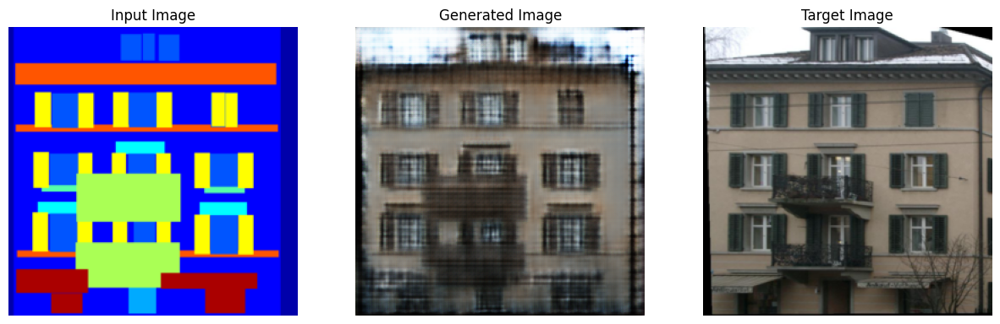

Epoch [24/100]: 100%|██████████| 95/95 [00:20<00:00,  4.56it/s, loss_disc=0.646, loss_gen=16.5]


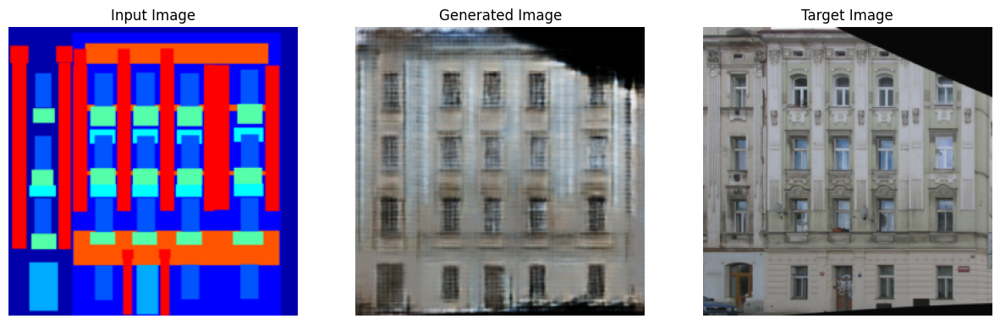

Epoch [29/100]: 100%|██████████| 95/95 [00:20<00:00,  4.53it/s, loss_disc=0.605, loss_gen=18.3]


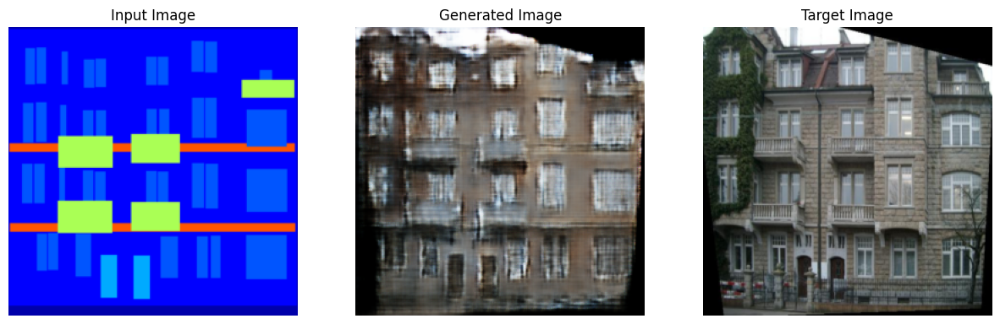

Epoch [34/100]: 100%|██████████| 95/95 [00:19<00:00,  4.96it/s, loss_disc=0.666, loss_gen=13.2]


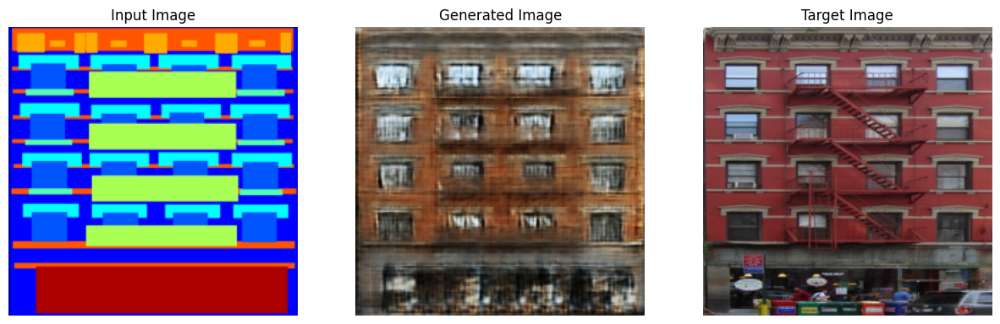

Epoch [39/100]: 100%|██████████| 95/95 [00:20<00:00,  4.65it/s, loss_disc=0.436, loss_gen=16.5]


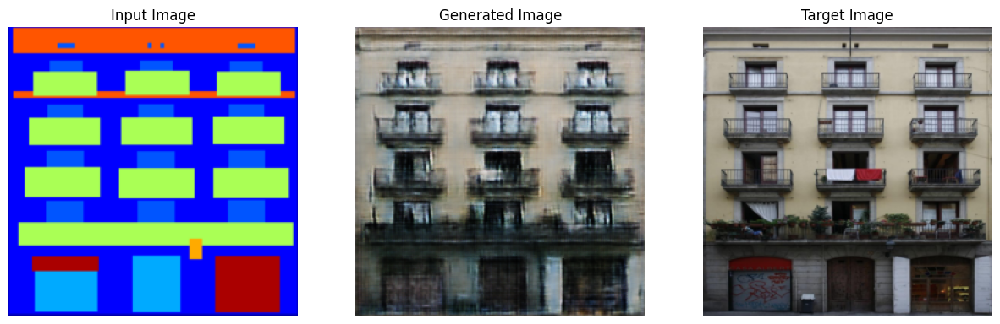

Epoch [44/100]: 100%|██████████| 95/95 [00:20<00:00,  4.58it/s, loss_disc=0.411, loss_gen=12.4]


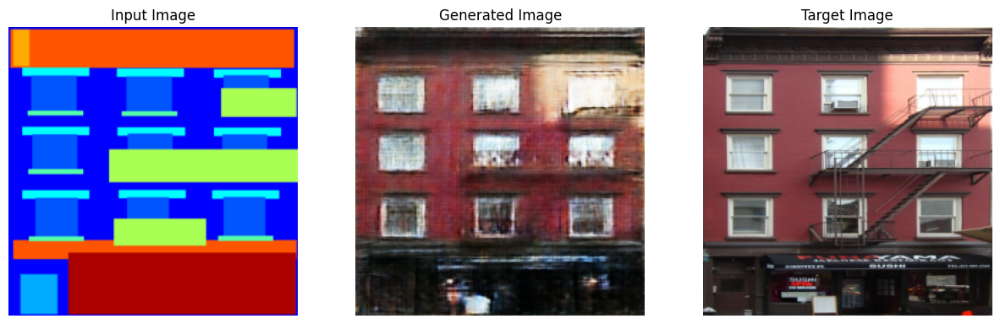

Epoch [49/100]: 100%|██████████| 95/95 [00:19<00:00,  4.90it/s, loss_disc=0.535, loss_gen=10.2]


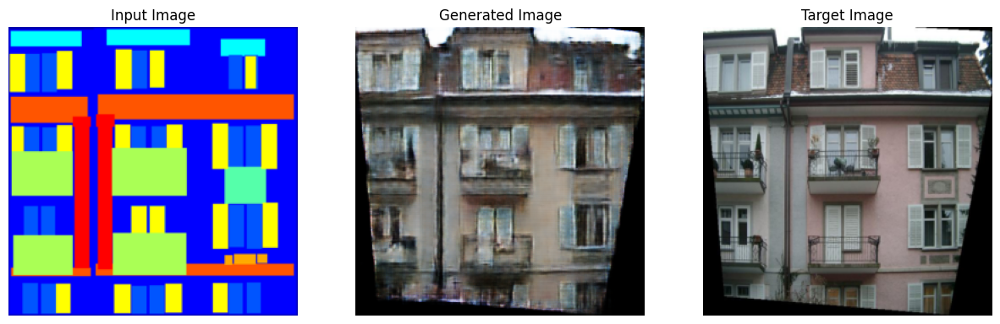

Epoch [54/100]: 100%|██████████| 95/95 [00:19<00:00,  4.78it/s, loss_disc=0.686, loss_gen=9.96]


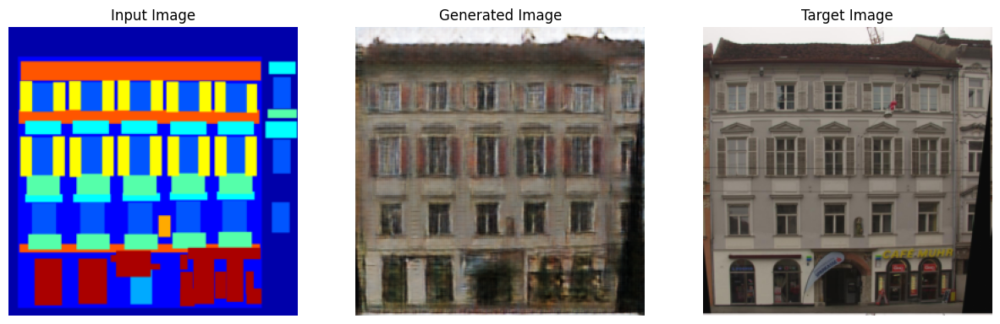

Epoch [59/100]: 100%|██████████| 95/95 [00:20<00:00,  4.74it/s, loss_disc=1.01, loss_gen=9.79] 


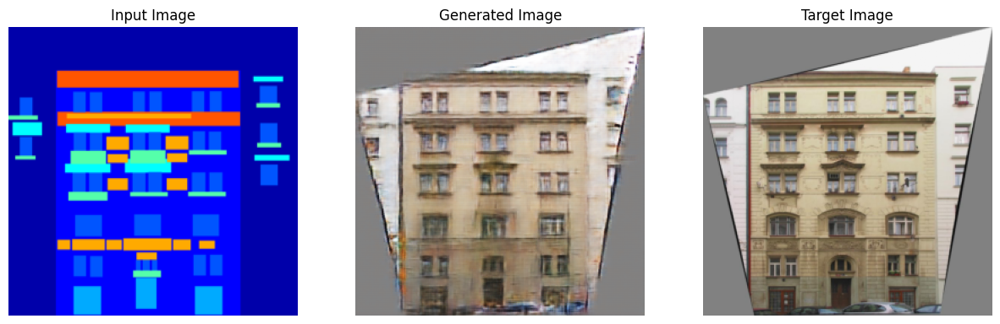

Epoch [64/100]: 100%|██████████| 95/95 [00:19<00:00,  4.87it/s, loss_disc=0.516, loss_gen=11]  


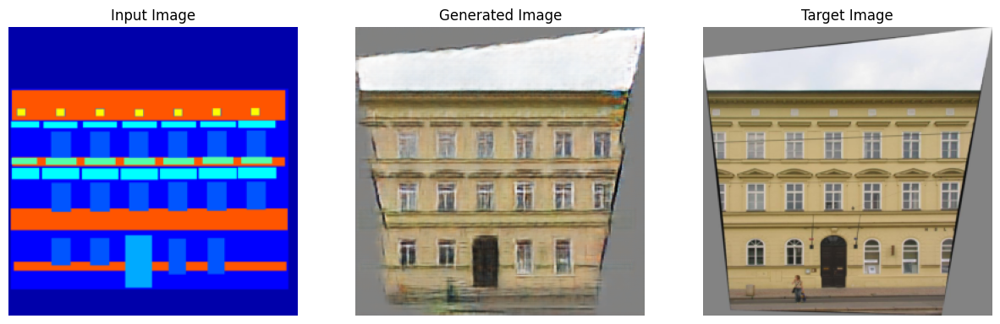

Epoch [69/100]: 100%|██████████| 95/95 [00:19<00:00,  4.80it/s, loss_disc=0.672, loss_gen=8.95]


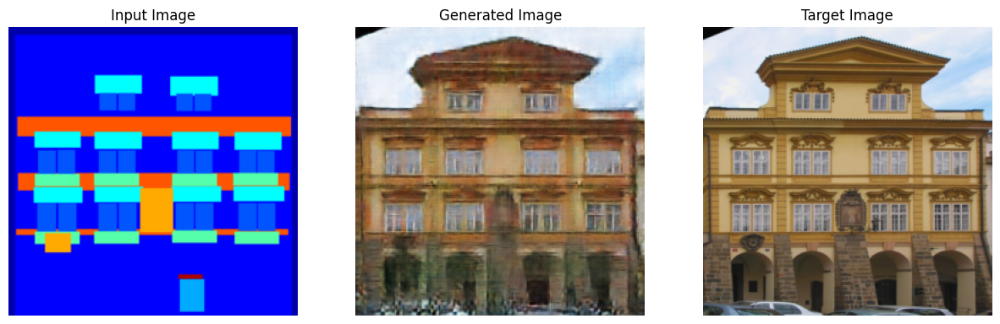

Epoch [74/100]: 100%|██████████| 95/95 [00:19<00:00,  4.88it/s, loss_disc=0.672, loss_gen=9.07]


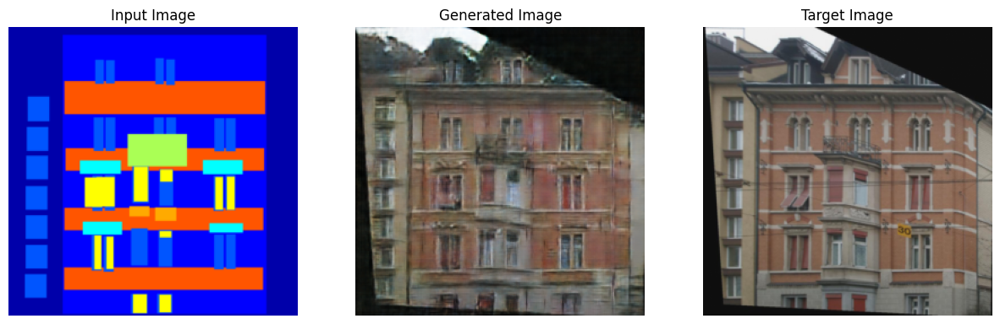

Epoch [79/100]: 100%|██████████| 95/95 [00:19<00:00,  4.96it/s, loss_disc=0.466, loss_gen=9.24]


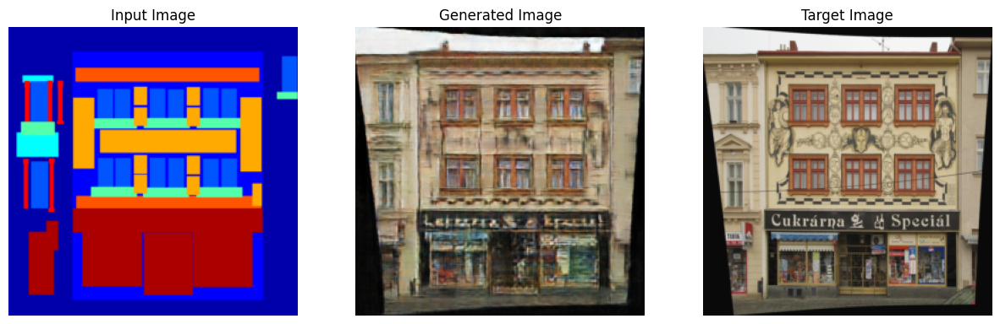

Epoch [84/100]: 100%|██████████| 95/95 [00:19<00:00,  4.78it/s, loss_disc=0.601, loss_gen=7.71]


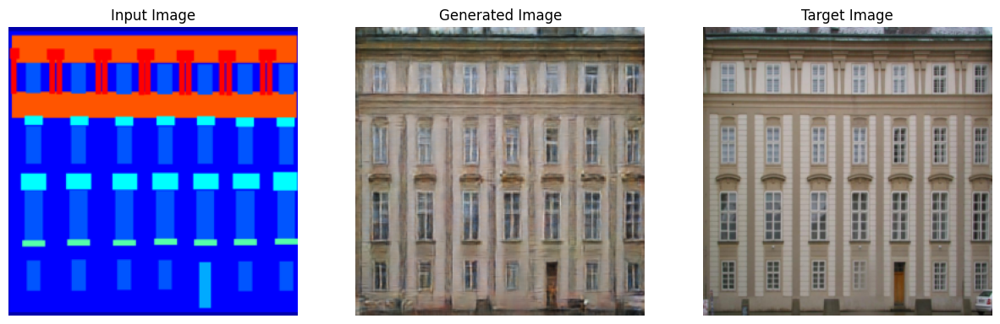

Epoch [89/100]: 100%|██████████| 95/95 [00:19<00:00,  4.81it/s, loss_disc=0.511, loss_gen=9.45]


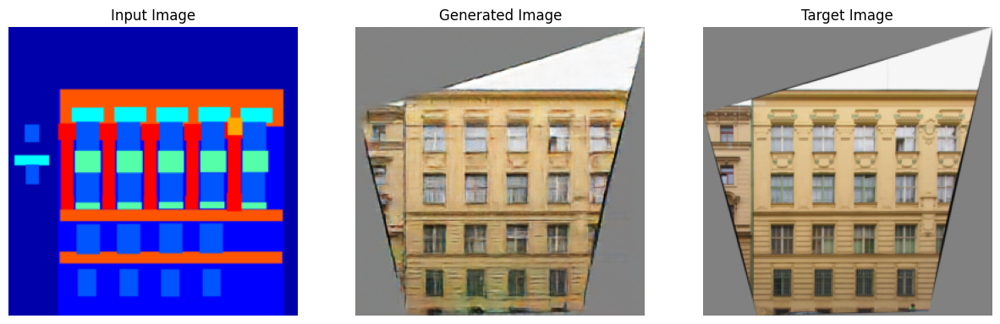

Epoch [94/100]: 100%|██████████| 95/95 [00:20<00:00,  4.68it/s, loss_disc=0.725, loss_gen=11.8]


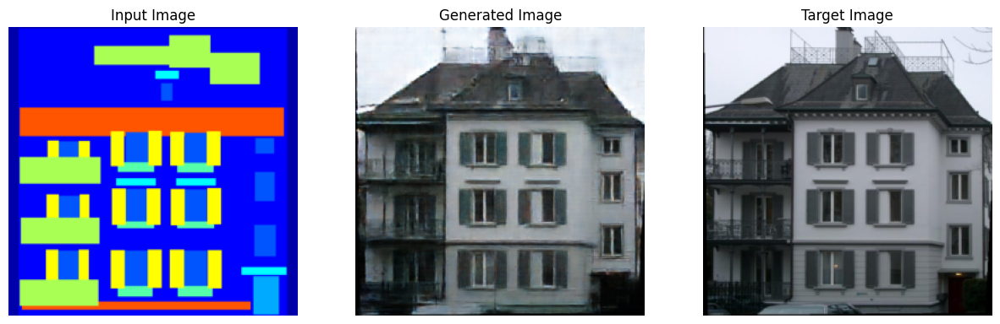

Epoch [99/100]: 100%|██████████| 95/95 [00:18<00:00,  5.23it/s, loss_disc=0.679, loss_gen=10.3]


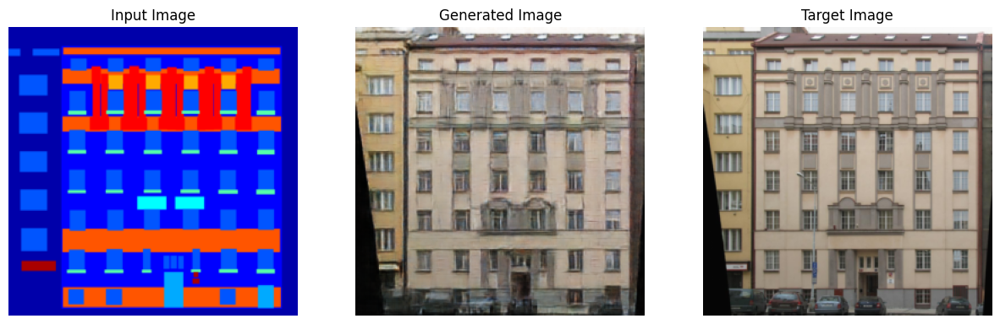

In [28]:
# Training Loop Implementation

import torch.optim as optim
import torch.nn.functional as F
from tqdm import tqdm

# Initialize optimizers for generator and discriminator
optimizer_gen = optim.Adam(gen.parameters(), lr=2e-4, betas=(0.5, 0.999))
optimizer_disc = optim.Adam(disc.parameters(), lr=2e-4, betas=(0.5, 0.999))

# Define loss functions
criterion_gan = nn.BCEWithLogitsLoss()
criterion_l1 = nn.L1Loss()

# Function to initialize weights
def initialize_weights(model):
    for m in model.modules():
        if isinstance(m, (nn.Conv2d, nn.ConvTranspose2d, nn.BatchNorm2d)):
            nn.init.normal_(m.weight.data, 0.0, 0.02)

# Initialize weights for generator and discriminator
initialize_weights(gen)
initialize_weights(disc)

# Training function
def train(dataloader, gen, disc, optimizer_gen, optimizer_disc, criterion_gan, criterion_l1, num_epochs=100):
    for epoch in range(num_epochs):
        loop = tqdm(dataloader, leave=True)
        for idx, (input_image, target_image) in enumerate(loop):
            input_image, target_image = input_image.to(device), target_image.to(device)

            # Train Discriminator
            optimizer_disc.zero_grad()
            fake_image = gen(input_image)
            real_output = disc(torch.cat((input_image, target_image), dim=1))
            fake_output = disc(torch.cat((input_image, fake_image.detach()), dim=1))
            loss_disc_real = criterion_gan(real_output, torch.ones_like(real_output))
            loss_disc_fake = criterion_gan(fake_output, torch.zeros_like(fake_output))
            loss_disc = (loss_disc_real + loss_disc_fake) / 2
            loss_disc.backward()
            optimizer_disc.step()

            # Train Generator
            optimizer_gen.zero_grad()
            fake_output = disc(torch.cat((input_image, fake_image), dim=1))
            loss_gen_gan = criterion_gan(fake_output, torch.ones_like(fake_output))
            loss_gen_l1 = criterion_l1(fake_image, target_image) * 100
            loss_gen = loss_gen_gan + loss_gen_l1
            loss_gen.backward()
            optimizer_gen.step()

            # Update tqdm loop
            loop.set_description(f"Epoch [{epoch}/{num_epochs}]")
            loop.set_postfix(loss_disc=loss_disc.item(), loss_gen=loss_gen.item())

        # Save and display images every 5 epochs
        if (epoch + 1) % 5 == 0:
            save_generated_images(epoch + 1, gen, dataloader, device)

# Start training
train(dataloader, gen, disc, optimizer_gen, optimizer_disc, criterion_gan, criterion_l1, num_epochs=100)

In [ ]:
# Save the trained model
torch.save(gen.state_dict(), "./models/generator.pth")

# Image Translation Functions
Create functions to perform image translation using the trained model and visualize results.

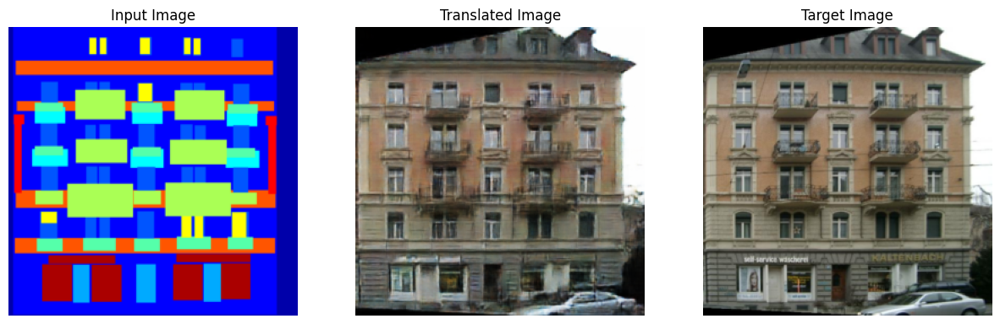

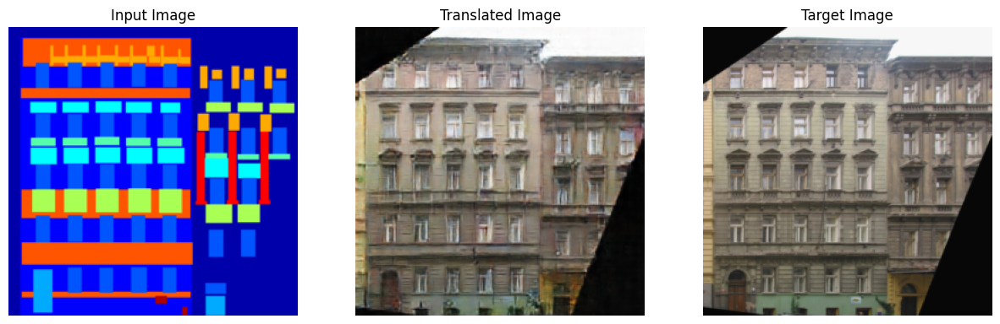

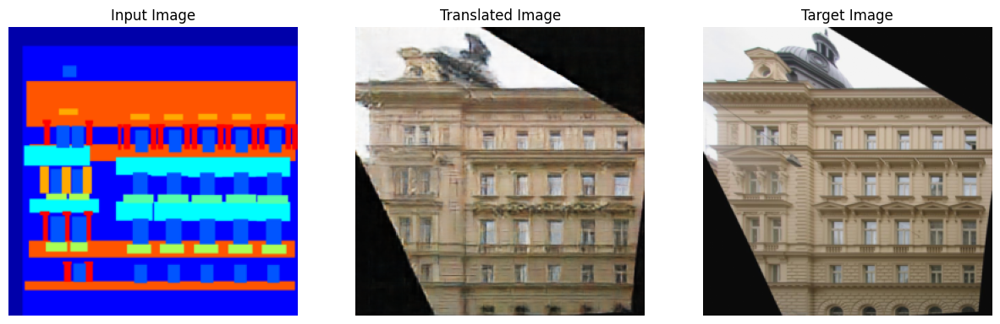

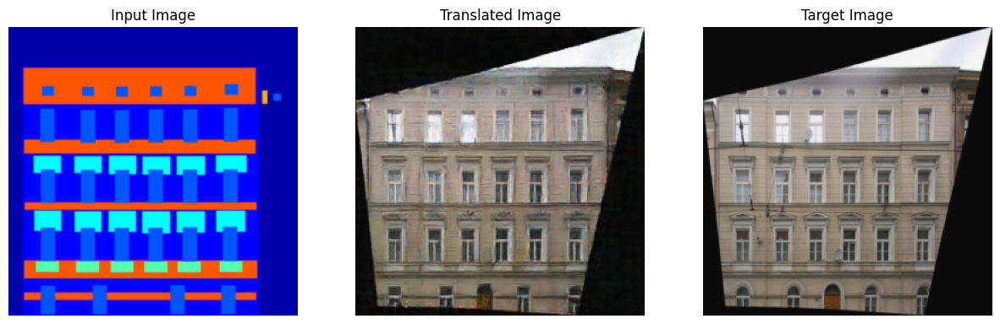

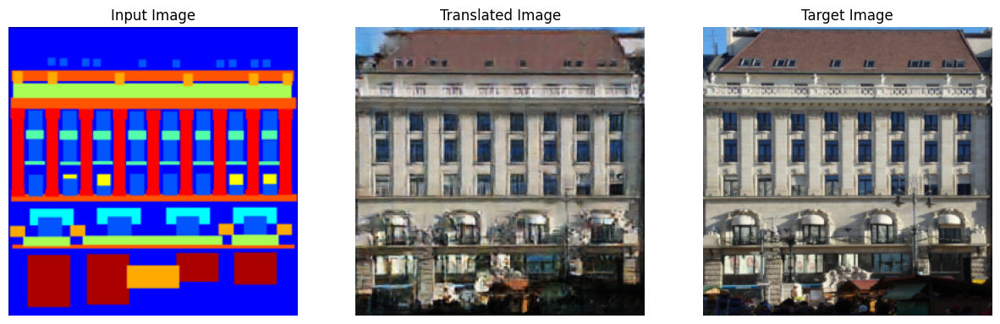

...

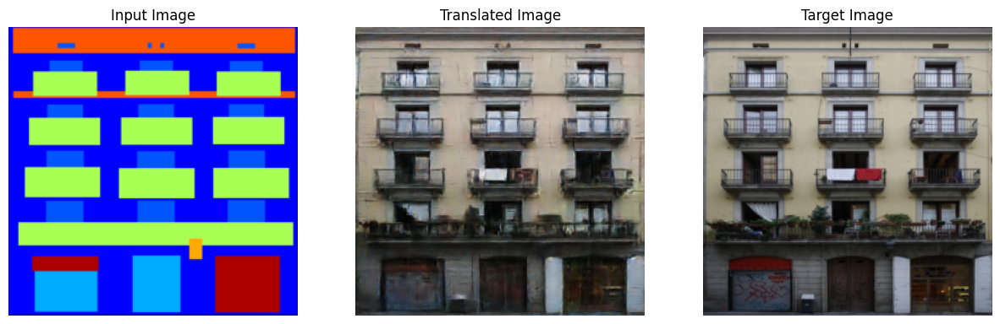

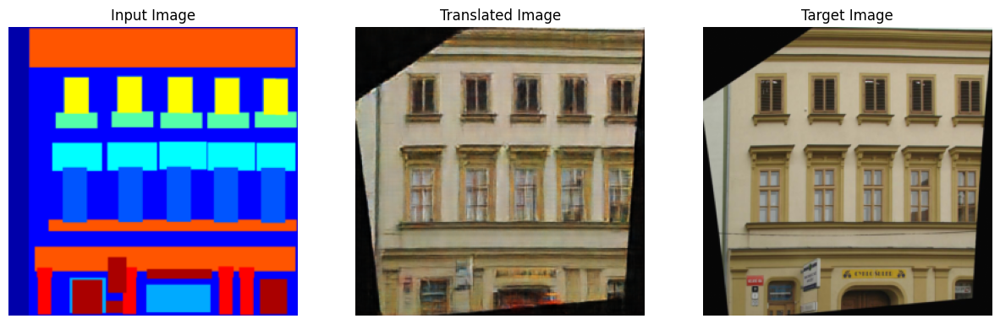

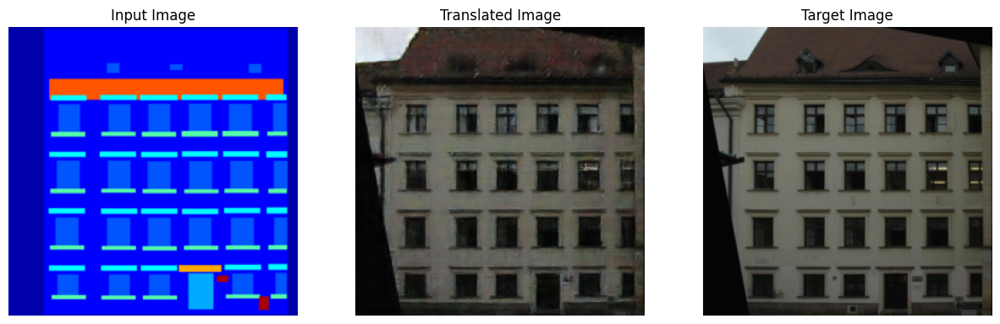

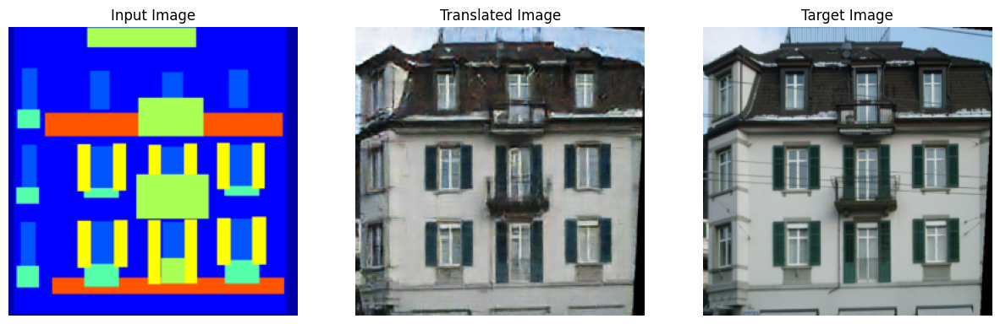

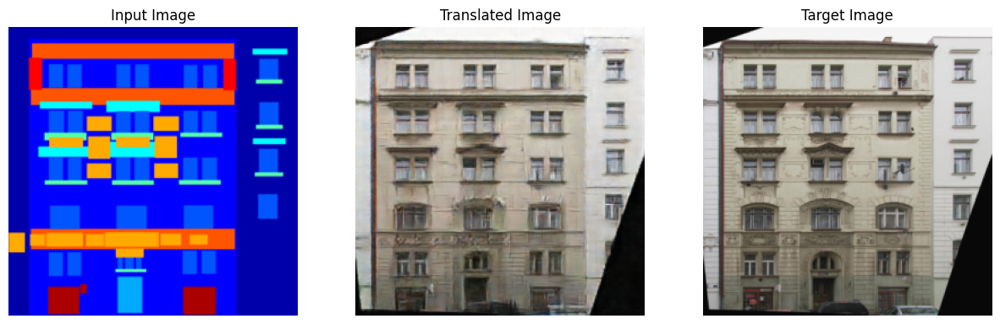

In [30]:
# Image Translation Functions

import torchvision.transforms as transforms

# Function to translate an image using the trained generator
def translate_image(generator, input_image, device):
    generator.eval()
    with torch.no_grad():
        input_image = input_image.to(device)
        translated_image = generator(input_image)
        
        # Convert batch of images to numpy arrays
        translated_images = []
        for i in range(translated_image.size(0)):
            img = translated_image[i].cpu()
            img = (img * 0.5) + 0.5  # Unnormalize the image
            img = img.permute(1, 2, 0).numpy()
            translated_images.append(img)
            
    return translated_images

# Function to visualize the input and translated images
def visualize_translation(generator, dataloader, device, num_images=5):
    generator.eval()
    for idx, (input_image, target_image) in enumerate(dataloader):
        if idx >= num_images:
            break
        translated_images = translate_image(generator, input_image, device)
        
        for i in range(len(translated_images)):
            input_img = input_image[i].permute(1, 2, 0).cpu().numpy()
            input_img = (input_img * 0.5) + 0.5  # Unnormalize the image
            target_img = target_image[i].permute(1, 2, 0).cpu().numpy()
            target_img = (target_img * 0.5) + 0.5  # Unnormalize the image

            fig, axes = plt.subplots(1, 3, figsize=(15, 5))
            axes[0].imshow(input_img)
            axes[0].set_title('Input Image')
            axes[0].axis('off')
            axes[1].imshow(translated_images[i])
            axes[1].set_title('Translated Image')
            axes[1].axis('off')
            axes[2].imshow(target_img)
            axes[2].set_title('Target Image')
            axes[2].axis('off')
            plt.show()

# Visualize translations
visualize_translation(gen, dataloader, device, num_images=5)

# Model Evaluation and Testing
Implement functions to evaluate model performance and generate sample translations.

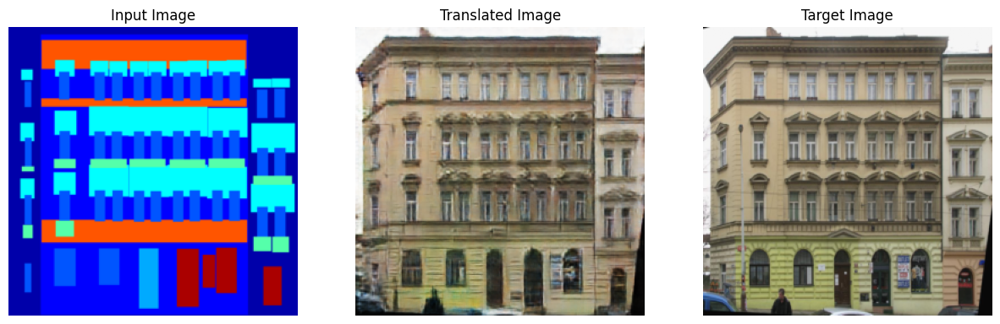

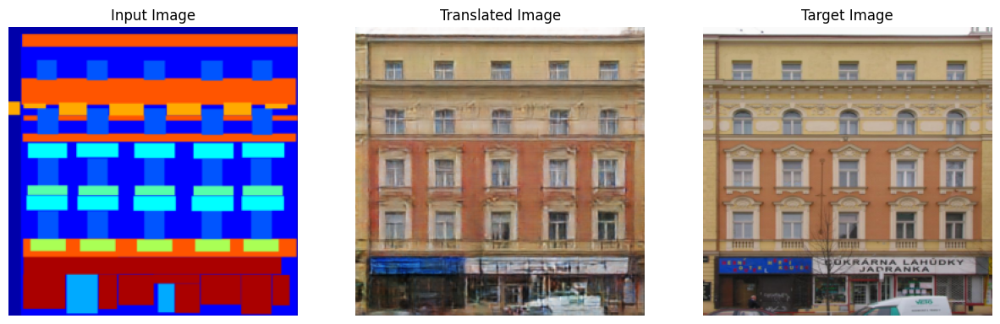

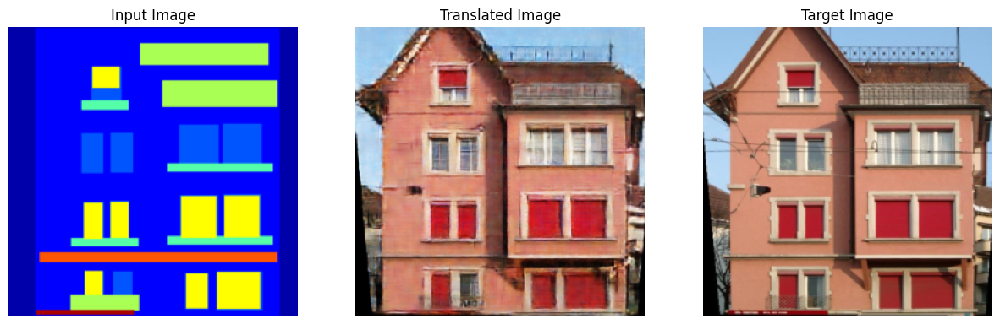

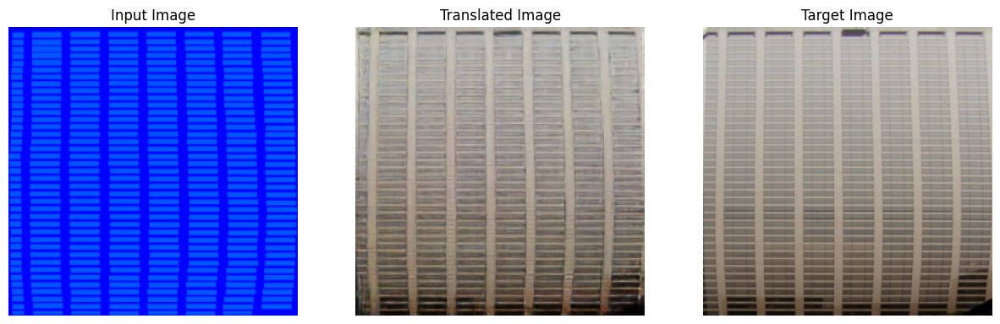

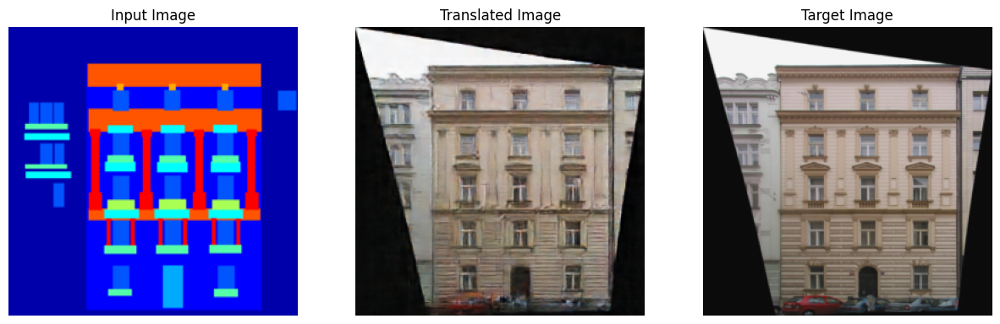

In [ ]:
# Model Evaluation and Testing

import torch
import torchvision.transforms as transforms
from PIL import Image
import matplotlib.pyplot as plt

# Function to translate an image using the trained generator
def translate_image(generator, input_image, device):
    generator.eval()
    with torch.no_grad():
        input_image = input_image.to(device)
        translated_image = generator(input_image)
        translated_image = translated_image.cpu().squeeze(0)
        translated_image = (translated_image * 0.5) + 0.5  # Unnormalize the image
        translated_image = transforms.ToPILImage()(translated_image)
    return translated_image

# Function to visualize the input and translated images
def visualize_translation(generator, dataloader, device, num_images=5):
    generator.eval()
    for idx, (input_image, target_image) in enumerate(dataloader):
        if idx >= num_images:
            break
        translated_image = translate_image(generator, input_image[0].unsqueeze(0), device)
        
        input_image = input_image[0].permute(1, 2, 0).cpu().numpy()
        input_image = (input_image * 0.5) + 0.5  # Unnormalize the image
        target_image = target_image[0].permute(1, 2, 0).cpu().numpy()
        target_image = (target_image * 0.5) + 0.5  # Unnormalize the image

        fig, axes = plt.subplots(1, 3, figsize=(15, 5))
        axes[0].imshow(input_image)
        axes[0].set_title('Input Image')
        axes[0].axis('off')
        axes[1].imshow(translated_image)
        axes[1].set_title('Translated Image')
        axes[1].axis('off')
        axes[2].imshow(target_image)
        axes[2].set_title('Target Image')
        axes[2].axis('off')
        plt.show()

# Visualize translations
visualize_translation(gen, dataloader, device, num_images=5)

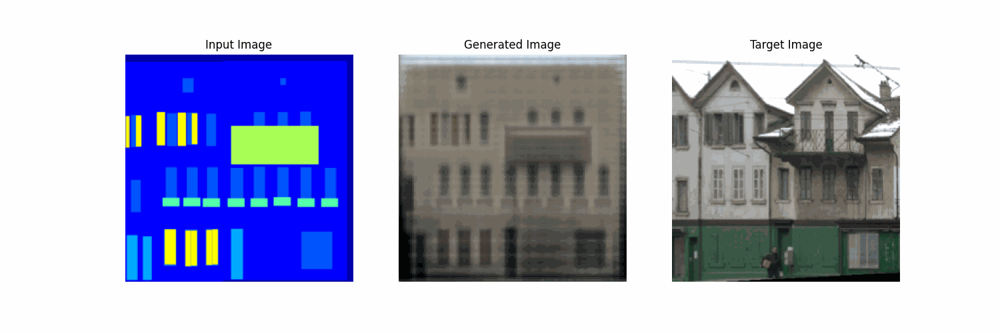

In [2]:
# Generate a GIF of the generated images
import imageio.v2 as imageio

images = []
for epoch in range(5, 101, 5):
    img_path = f"./assets/generated_images/epoch_{epoch}.png"
    images.append(imageio.imread(img_path))
imageio.mimsave('./assets/generated_images.gif', images, fps=2, loop=0)

# Display the generated images gif
from IPython.display import Image

Image(filename='./assets/generated_images.gif')
